In [1]:
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import random
import time

import collections
import requests

import pickle

from urllib.request import Request, urlopen
from urllib.error import URLError
from bs4 import BeautifulSoup
from multiprocessing.pool import ThreadPool
import requests
#!pip install line_profiler
%load_ext line_profiler

In [35]:
matplotlib.rcParams["axes.titlesize"] = 16
matplotlib.rcParams["axes.labelsize"] = 13

matplotlib.rcParams["xtick.labelsize"] = 16
matplotlib.rcParams["ytick.labelsize"] = 16
matplotlib.rcParams["axes.grid"] = True
matplotlib.rcParams["xtick.major.size"] = 12
matplotlib.rcParams["ytick.major.size"] = 12
matplotlib.rcParams["xtick.major.width"] = 2
matplotlib.rcParams["ytick.major.width"] = 2

# Task 1)

In [2]:
N = 2*10**4

G = nx.barabasi_albert_graph( N , 1) #Creating a nx.Graph object

#degree counting 
def deg_dist(G):
    degreeSequence = sorted([d for n, d in G.degree()]) #degree list - ascending
    degreeCount = collections.Counter(degreeSequence)
    deg, cnt = zip( *degreeCount.items() )
    return deg, cnt

def plot_deg_dist(deg,cnt):
    plt.bar(deg,[x/N for x in cnt], color="tab:orange", label="degree distribution") #It would be more practical to use a histogram, but it is prettier
    plt.grid()


    deg_grid = np.arange(1,max(deg)+1, dtype = float)
    plt.plot( deg_grid ,[2.5 * k**(-3) for k in deg_grid],
             color="tab:green",ls="--",label="theoretical distribution: ~$k^{-3}$") #source: Wiki on Barabási-Albert network
    plt.title(f"{N} node degree distribution",size=24)
    plt.xlabel("k - degree", size=20)
    plt.ylabel("$P_k$",size=20)

    plt.legend(fontsize=14)
    plt.yscale("log")
    plt.xlim(0,50)

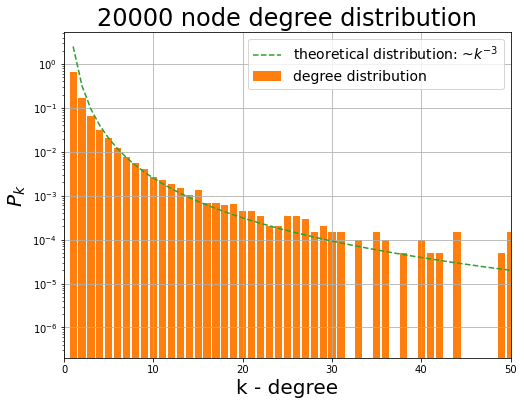

In [3]:

fig,ax = plt.subplots(figsize=[8,6])
deg, cnt = deg_dist(G)

plot_deg_dist(deg, cnt)

In [4]:
def swap_edge(i,ax):
    edgeList = list(G.edges)
    edgeCount = len(G.edges)
    ax.clear()
    #oops_meter = 0
    #get a random index pair (row,col) from the adjacency matrix
    chosenEdge = random.choice(edgeList)
    for j in range(100):
        
        #find non-existing edge: check if a random index pair is not in the edge list
        plannedEdge = [random.randint(0,edgeCount),random.randint(0,edgeCount)]
        if plannedEdge not in G.edges:
        
        #delete chosen edge, add the planned edge
            try:
                G.remove_edge(*chosenEdge)
            except Exception: #Some unkown error happens sometimes
                pass #oops_meter +=1
            G.add_edge(*plannedEdge)
            break

    deg, cnt = deg_dist(G)
    plot_deg_dist(deg,cnt)

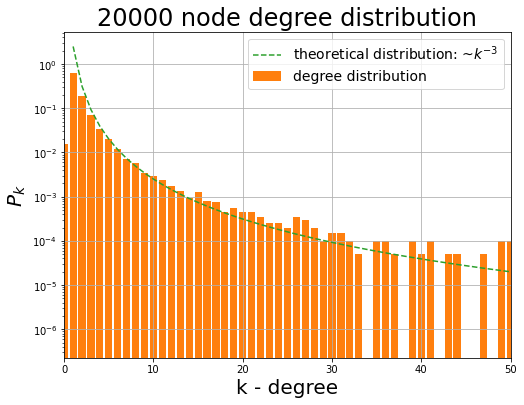

In [5]:
fig, ax = plt.subplots(figsize=[8,6])
ani = FuncAnimation(fig, swap_edge, interval = 1, fargs = [ax], repeat = False, frames = 500)
#ani.save('task1.gif', writer='ffmpeg')
HTML(ani.to_jshtml())

The animation suggests that by swapping the edges the degree distribution gets closer to the theoretical distribution.

# Task 2)

In [6]:
elte_url = "https://www.elte.hu/"
wiki_url = "https://hu.wikipedia.org"

def check_elte(link):
        '''
        Checking if the link stays on the elte.hu domain.
        It means, that it is either an elte.hu domain member page
        or it does not contain / or # or it is not an email address.
        '''
        if ( ("#" not in link) and ("mailto" not in link) and ("/" not in link) ) or ("elte.hu" in link):
            return True
        else:
            return False

#I didnt use it later
def check_wiki(link):
    '''
    Check if the link references another wiki article or points to an outside source.
    '''
    return "/wiki/" in link


def mine_page(url_end):
    #if not not layers: #check if there had been previous requests

    #    if url_end in layers[-1].keys(): #check if the webpage had been requested before
    #        return layers[-1][ url_end ] #get the links of the webpage from previous requests


    
    response = requests.get(elte_url + url_end) #GET request of the particalur page
    soup = BeautifulSoup(response.text, "lxml") #Parsing the page
    
    links = soup.findAll(href = True) #Find every href key on the page
    
    links = [ x["href"] for x in links ] #Extract href value
    links = [ *filter(check_elte, links) ]
    return {url_end: links}


def mp( fun, fun_arg_list ):
    '''
    Starting multiple threads to execute my function
    '''
    pool = ThreadPool(processes=16) #the maximum number of threads on the machine I work is 16

    # start the threads and give them the functions to work with
    async_results = [ pool.apply_async(fun, (x,)) for x in fun_arg_list ] 
    return_vals = [ x.get() for x in async_results ]  #joining the threads and getting the return values
    return return_vals

flatten = lambda t: [item for sublist in t for item in sublist]

def prepare_op(op):
    '''
    Flatten and remove duplicates from the output of fun mine_elte
    '''
    return set(flatten(flatten([element.values() for element in op])))

def add_my_edges(layer, Graph):
    '''
    Make an edgelist from the key-value format of a layer and add them to Graph.
    Returns modified nx.Graph
    '''
    temp = []
    for element in layer:
        for key in element.keys():
            for value in element[key]:
                temp.append((key, value))
    Graph.add_edges_from(set(temp))
    return G

In [7]:
%lprun -f mine_page mine_page("") #Since this code is going to be run ~10^6 times, it needs to be pretty quick

The output of lprun is in a popup window, which is not converted into html, so I attached it as a picture.
![lprun popup](lprun_popup.png)

In [8]:
#This is how the output of a run looks like: key-value pairs, 
#where the key is the original website and the value 
#is the list of hrefs found on that website
mine_page("")

{'': ['https://www.elte.hu/',
  'https://www.elte.hu/',
  'https://www.elte.hu/en/',
  'https://www.elte.hu/de',
  'felveteli',
  'felvettek',
  'hallgatoknak',
  'munkatarsaknak',
  'https://www.alumni.elte.hu',
  'elte-univerzum',
  'javascript:;',
  'https://www.elte.hu/akadalymentesitesi-nyilatkozat',
  'https://www.elte.hu/',
  'elte',
  'tortenet',
  'karok',
  'kivalosagaink',
  'vezetes',
  'szervezet',
  'erdekkepviselet',
  'minosegbiztositas',
  'nemzetkoziesites',
  'szabalyzatok',
  'kozerdeku',
  'egyuttmukodesek',
  'kiadvanyok',
  'hirek-esemenyek',
  'hirek',
  'esemeny',
  'interju',
  'palyazatok-felhivasok',
  'kozlemenyek',
  'sajto',
  'sajtofigyelo',
  'hirlevel',
  'oktatas',
  'indulo-kepzesek',
  'kpr',
  'kivalo-oktatoink',
  'tehetseggondozas',
  'kozepiskolasoknak',
  'felvetelizoknek',
  'felvetteknek',
  'nyelvoktatas',
  'habilitacio',
  'idegen-nyelvu-kepzesek',
  'tanulmanyi_hivatalok',
  'quaestura',
  'neptun',
  'elearning',
  'kutatas',
  'kivalo-k

In [9]:
layers = []

t1 = time.time()
layers.append(mine_page("")) #0th layer
print(f"Layer 0 --- took {round(time.time()-t1 ,3) } s")

t1 = time.time()
layers.append( mp( mine_page, set(*layers[0].values()) ) )
print(f"Layer 1 --- it took {round(time.time()-t1,3)}s")

for i in range(2, 9):
    t1 = time.time()

    _layer = mp( mine_page, prepare_op( layers[i-1] ) )
    print(f"Layer {i} --- it took {round(time.time()-t1,3)}s")
    layers.append(_layer)

Layer 0 --- took 0.699 s
Layer 1 --- it took 9.25s
Layer 2 --- it took 158.347s
Layer 3 --- it took 198.663s
Layer 4 --- it took 211.494s
Layer 5 --- it took 221.628s
Layer 6 --- it took 249.495s
Layer 7 --- it took 248.282s
Layer 8 --- it took 255.951s


In [10]:
#with open("elte_network.pkl","wb") as f:
    #pickle.dump(layers,f)

In [11]:
#Making a Graph out of the layers

G = nx.Graph()
n_edges = []
n_nodes = []
diams = []


temp = []
for key in layers[0].keys():
        for value in layers[0][key]:
            temp.append((key, value))
G.add_edges_from(temp)

n_edges.append(len(G.edges))
n_nodes.append(len(G.nodes))
diams.append(nx.diameter(G))
print("Number of edges, Number of nodes, Diameter")
print(0,len(G.edges), len(G.nodes), nx.diameter(G))


for i,layer in enumerate(layers[1:]):
    G = add_my_edges(layer, G)
    print( i+1 ,len(G.edges), len(G.nodes), nx.diameter(G))
    n_edges.append(len(G.edges))
    n_nodes.append(len(G.nodes))
    diams.append(nx.diameter(G))

Number of edges, Number of nodes, Diameter
0 113 114 2
1 9004 2680 3
2 248288 3273 4
3 304368 3449 4
4 320913 3451 4
5 321102 3453 4
6 321291 3455 4
7 321480 3457 4
8 321669 3459 4


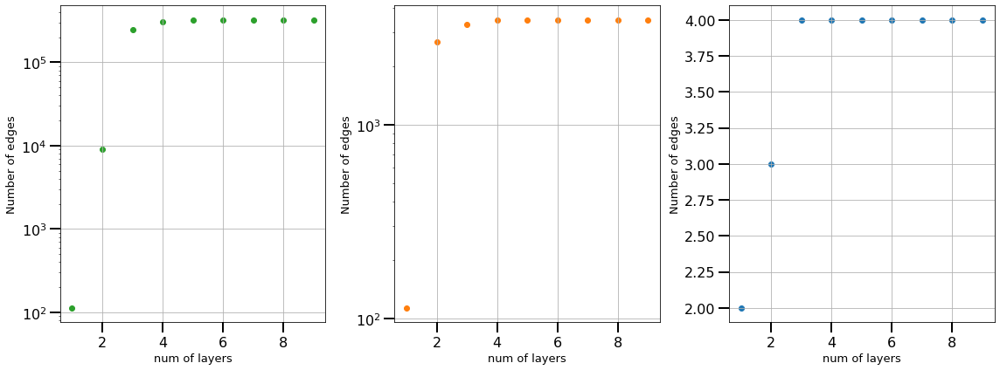

In [38]:
fig, ax = plt.subplots(1,3, figsize=[16,6])

ax[0].scatter(range(1,10), n_edges, color ="tab:green")
ax[0].set_yscale("log")
ax[0].set_ylabel("Number of edges")
ax[0].set_xlabel("num of layers")

ax[1].scatter(range(1,10), n_nodes, color ="tab:orange")
ax[1].set_yscale("log")
ax[1].set_ylabel("Number of edges")
ax[1].set_xlabel("num of layers")


ax[2].scatter(range(1,10), diams, color ="tab:blue")
ax[2].set_ylabel("Network diameter")
ax[2].set_xlabel("num of layers")


plt.tight_layout()

These graphs show us the number of edges, nodes and network diameter, when adding more and more layers to the network. One layer means the list of nodes, that is connected to the network's previous state. For example, in the beginning the network is only the  `elte.hu` webpage, then we connect those pages to this node, which have a href on this webpage. Next we look at each newly connected webpage, and look for hrefs on them. Connect these new pages to the given page's node in the network.
<br><br>
We can conclude, that from about the 4th layer there is no substantial amount of nodes or edges added to the network. Other than that, the main goal was to show the diameter of the network while adding nodes to it. It is clearly visible, that the after that 4th layer the network diameter stops changing, it is stuck at 4.

## Task 3

Animation size has reached 21082255 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


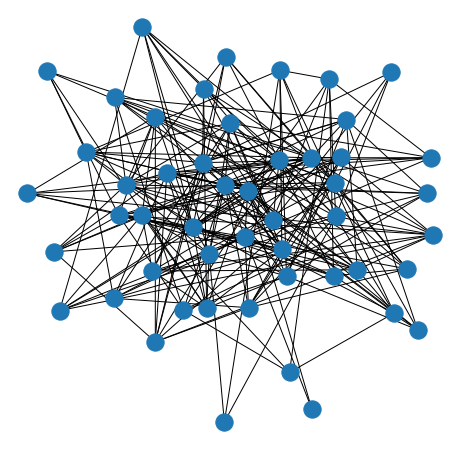

In [12]:
# During reconnecting (swapping) links between nodes, usually we need a constant quantity, which does not change during the swapping of links. 
# E.g. one can fix the degree distribution by setting a constraint at each node, 
# how many incoming/outgoing connection it must have. Create small networks (N<50 nodes), 
# which are randomized with swapping the links constraining the degrees of each node. 
# By creating a visual representation of the network track the changes of swapping of the links!
# Show some examples, where this type of randomization does not change the topology of the network at all.

import numpy as np
import networkx as nx
import matplotlib.pyplot as plt 
from matplotlib import animation

def anim(i, ax):
    ax.clear()
    nx.double_edge_swap(G) #this is swapping nodes while their degrees are fixed
    nx.draw(G, pos = layout, ax = ax)

G = nx.fast_gnp_random_graph(50, 0.2)
layout = nx.spring_layout(G)

fig, ax = plt.subplots(figsize=[8,8])

ani = animation.FuncAnimation(fig, anim, fargs = [ax], repeat = False)
#ani.save('network_anim3.gif', writer='imagemagick')
HTML(ani.to_jshtml())